In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn as skl
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import balanced_accuracy_score, confusion_matrix, classification_report
df= pd.read_csv('Resources/Raw_data.csv')
df.head()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,3,80.0,0,1,2,25.19,6.6,140,0
1,3,54.0,0,0,3,27.32,6.6,80,0
2,2,28.0,0,0,2,27.32,5.7,158,0
3,3,36.0,0,0,4,23.45,5.0,155,0
4,2,76.0,1,1,4,20.14,4.8,155,0


In [2]:
scaler= StandardScaler().fit_transform(df)
scaler[0:5]

array([[ 8.40111264e-01,  1.69270354e+00, -2.84439447e-01,
         4.93637859e+00, -9.16332959e-01, -3.21055792e-01,
         1.00170572e+00,  4.77042159e-02, -3.04788738e-01],
       [ 8.40111264e-01,  5.38006427e-01, -2.84439447e-01,
        -2.02577655e-01, -2.01854464e-01, -1.15583678e-04,
         1.00170572e+00, -1.42620999e+00, -3.04788738e-01],
       [-1.18855498e+00, -6.16690686e-01, -2.84439447e-01,
        -2.02577655e-01, -9.16332959e-01, -1.15583678e-04,
         1.61108022e-01,  4.89878478e-01, -3.04788738e-01],
       [ 8.40111264e-01, -2.61399267e-01, -2.84439447e-01,
        -2.02577655e-01,  5.12624030e-01, -5.83232300e-01,
        -4.92690191e-01,  4.16182767e-01, -3.04788738e-01],
       [-1.18855498e+00,  1.51505783e+00,  3.51568677e+00,
         4.93637859e+00,  5.12624030e-01, -1.08197037e+00,
        -6.79489680e-01,  4.16182767e-01, -3.04788738e-01]])

In [3]:
y= df['diabetes']
x= df.drop(['diabetes'], axis= 1)

In [4]:
x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.2, random_state=1)

In [5]:
from sklearn.linear_model import LogisticRegression
model_1 = LogisticRegression()
model_1.fit(x_train, y_train)
y1_pred= model_1.predict(x_test)

C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [6]:
from sklearn.metrics import accuracy_score
accuracy_1= accuracy_score(y_test, y1_pred)
class_1= classification_report(y_test, y1_pred)
print(f'Accuracy of Diabetes: {accuracy_1}')

Accuracy of Diabetes: 0.9582


In [7]:
print(class_1)

              precision    recall  f1-score   support

           0       0.97      0.99      0.98     18299
           1       0.84      0.62      0.72      1701

    accuracy                           0.96     20000
   macro avg       0.90      0.81      0.85     20000
weighted avg       0.96      0.96      0.96     20000



<Axes: >

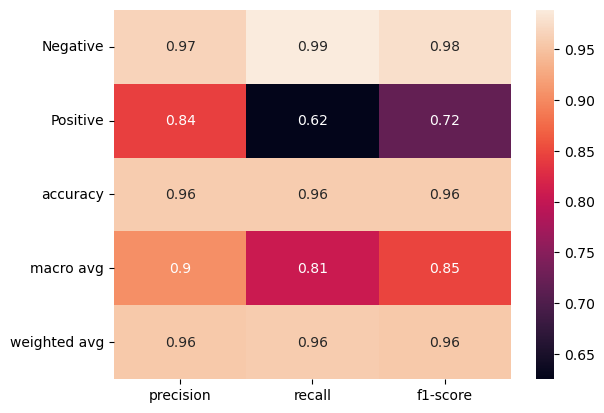

In [8]:
import seaborn as sns

target_names= ['Negative', 'Positive']

clf_report = classification_report(y_test,
                                   y1_pred,
                                   target_names=target_names,
                                   output_dict=True)

sns.heatmap(pd.DataFrame(clf_report).iloc[:-1, :].T, annot=True)

In [9]:
from imblearn.over_sampling import RandomOverSampler
ros= RandomOverSampler(random_state=78)
x_ros, y_ros= ros.fit_resample(x_train, y_train)

In [10]:
model_2 = LogisticRegression()
model_2.fit(x_ros, y_ros)
y2_pred= model_2.predict(x_test)

C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [11]:
accuracy_2= accuracy_score(y_test, y2_pred)
class_2= classification_report(y_test, y2_pred)
print(f'Accuracy of Diabetes: {accuracy_2}')
print(class_2)

Accuracy of Diabetes: 0.88555
              precision    recall  f1-score   support

           0       0.99      0.89      0.93     18299
           1       0.42      0.88      0.57      1701

    accuracy                           0.89     20000
   macro avg       0.70      0.88      0.75     20000
weighted avg       0.94      0.89      0.90     20000



<Axes: >

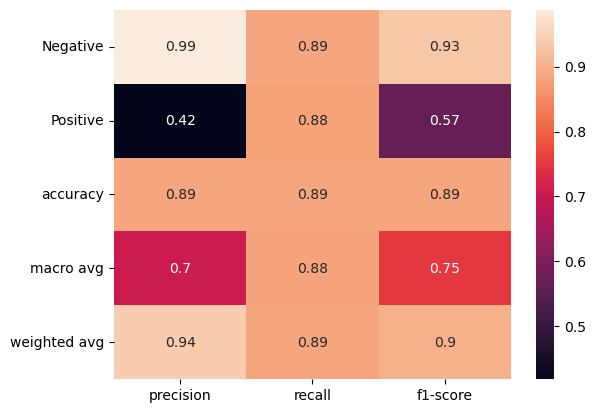

In [12]:
labels = np.arange(8)
target_names= ['Negative', 'Positive']

clf_report = classification_report(y_test,
                                   y2_pred,
                                   target_names=target_names,
                                   output_dict=True)

sns.heatmap(pd.DataFrame(clf_report).iloc[:-1, :].T, annot=True)

In [13]:
import hvplot.pandas
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
k1= list(range(1, 11))

In [14]:
inertia1= []
for i in k1:
    k1_model = KMeans(n_clusters=i, random_state=0)
    k1_model.fit(df)
    inertia1.append(k1_model.inertia_)

C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaco

In [15]:
elbow_data1 = {"k1": k1, "inertia1": inertia1}

df_elbow1 = pd.DataFrame(elbow_data1)

In [16]:
df_elbow1.hvplot.line(
    x="k1",
    y="inertia1",
    title="Elbow Curve1",
    xticks=k1
)

:Curve   [k1]   (inertia1)

In [17]:
model = KMeans(n_clusters=4, random_state=0)

In [18]:
model.fit(df)

C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=0)

In [19]:
k_predictions = model.predict(df)

print(k_predictions)

[2 1 3 ... 2 1 1]


In [20]:
predictions_df=pd.DataFrame(df).copy()

In [22]:
predictions_df["Clusters"]=k_predictions
predictions_df.head()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes,Clusters
0,3,80.0,0,1,2,25.19,6.6,140,0,2
1,3,54.0,0,0,3,27.32,6.6,80,0,1
2,2,28.0,0,0,2,27.32,5.7,158,0,3
3,3,36.0,0,0,4,23.45,5.0,155,0,3
4,2,76.0,1,1,4,20.14,4.8,155,0,2


In [29]:
predictions_df.hvplot.scatter(
    x= 'diabetes',
    y= ['gender','age', 'hypertension', 'heart_disease', 'smoking_history', 'bmi', 'HbA1c_level', 'blood_glucose_level'],
    by="Clusters")

:NdOverlay   [Variable]
   :Scatter   [diabetes]   (value)

In [23]:
pca=PCA(n_components=3)
df_PCA = pca.fit_transform(df)
df_PCA[:5]

array([[  5.25062788, -37.35106444,  -6.14597577],
       [-56.75378173, -17.18731719,  -0.77012337],
       [ 18.63951868,  15.54760027,   1.28371366],
       [ 16.28467068,   7.74176348,  -3.37587851],
       [ 19.7427977 , -31.53733323, -10.87836887]])

In [24]:
pca.explained_variance_ratio_

array([0.75352393, 0.22751888, 0.01740994])

In [26]:
pca_df = pd.DataFrame(df_PCA, columns=["PCA1","PCA2","PCA3"])
pca_df.head()

,PCA1,PCA2,PCA3
0,5.250628,-37.351064,-6.145976
1,-56.753782,-17.187317,-0.770123
2,18.639519,15.547600,1.283714
3,16.284671,7.741763,-3.375879
4,19.742798,-31.537333,-10.878369


In [27]:
k2 = list(range(1, 11))
inertia2= []

for i in k2:
    k2_model = KMeans(n_clusters=i, random_state=0)
    k2_model.fit(pca_df)
    inertia2.append(k2_model.inertia_)

C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\sbelz\anaco

In [28]:
elbow_data2 = {"k2": k2, "inertia2": inertia2}

df_elbow2 = pd.DataFrame(elbow_data2)

df_elbow2.head()

,k2,inertia2
0,1,2.208296e+08
1,2,1.238452e+08
2,3,7.717406e+07
3,4,5.476133e+07
4,5,4.439272e+07


In [29]:
df_elbow2.hvplot.line(
    x="k2",
    y="inertia2",
    title="Elbow Curve 2",
    xticks=k2
)

:Curve   [k2]   (inertia2)

In [30]:
model = KMeans(n_clusters=4, random_state=0)
model.fit(pca_df)
k_4 = model.predict(pca_df)
print(k_4)

C:\Users\sbelz\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


[3 0 1 ... 3 0 0]


In [35]:
pca_predictions_df = pca_df.copy()

pca_predictions_df["Clusters"]=k_4

pca_predictions_df.head()

,PCA1,PCA2,PCA3,Clusters
0,5.250628,-37.351064,-6.145976,3
1,-56.753782,-17.187317,-0.770123,0
2,18.639519,15.547600,1.283714,1
3,16.284671,7.741763,-3.375879,1
4,19.742798,-31.537333,-10.878369,3


In [32]:
pca_predictions_df.hvplot.scatter(
    x="PCA1",
    y="PCA2",
    by="Clusters"
)

:NdOverlay   [Clusters]
   :Scatter   [PCA1]   (PCA2)